# Conceitos Básicos

In [31]:
import numpy as np

# biblioteca para computação quântica
from qiskit import *
import qiskit.quantum_info as qi
from qiskit.visualization import plot_bloch_multivector
from qiskit.visualization import visualize_transition

## Operações com Numpy

In [12]:
# Definição kets com numpy (vetores colunas)

ket0 = np.array([
    [1],
    [0]
])

print(ket0)

ket1 = np.array([
    [0],
    [1]
])

print('\n', ket1)

[[1]
 [0]]

 [[0]
 [1]]


In [13]:
# Obtensão dos bras

adjunto = lambda x: np.transpose(np.conjugate(x)) #Transposição também pode ser feito com matriz.T

bra0 = adjunto(ket0)
print(bra0)

bra1 = adjunto(ket1)
print('\n', bra1)

[[1 0]]

 [[0 1]]


In [14]:
# Operador Densidade

rho0 = ket0 @ bra0 # @ faz operação de matrizes
print(rho0)

rho1 = ket1 @ bra1
print('\n', rho1)

[[1 0]
 [0 0]]

 [[0 0]
 [0 1]]


In [22]:
# Estado produto de 2 qubits

# Kets
ket00 = np.kron(ket0, ket0) # Operação de produto tensorial
ket01 = np.kron(ket0, ket1)
ket10 = np.kron(ket1, ket0)
ket11 = np.kron(ket1, ket1)
print(ket00)

# Matriz densidade
rho00 = np.kron(rho0, rho0)
rho01 = np.kron(rho0, rho1)
rho10 = np.kron(rho1, rho0)
rho11 = np.kron(rho1, rho1)
print('\n', rho00)

[[1]
 [0]
 [0]
 [0]]

 [[1 0 0 0]
 [0 0 0 0]
 [0 0 0 0]
 [0 0 0 0]]


In [23]:
# Operaçao sigma_x
X = np.array([
    [0, 1],
    [1, 0]
])

# Operação sigma_y
Y = np.array([
    [0, -1j],
    [1j, 0]
])

# Operação sigma_z
Z = np.array([
    [1, 0],
    [0, -1]
])


# Operação de Identidade
Id = np.identity(2)


# Operação de Hadamard
Had = (1 / np.sqrt(2)) * np.array([
    [1, 1],
    [1, -1]
])

In [24]:
# Aplicação de um operador a um estado
ket_psi = Had @ ket0

rho_psi = ket_psi @ adjunto(ket_psi)
print(rho_psi)

traco = np.trace(rho_psi) # operação de traço
print('\n', traco)

[[0.5 0.5]
 [0.5 0.5]]

 0.9999999999999998


## Operações com Qiskit

In [26]:
# Operação de Traço Parcial

r1 = qi.partial_trace(rho10, [0])
print(r1)

r0 = qi.partial_trace(rho10, [1])
print('\n', r0)

DensityMatrix([[0.+0.j, 0.+0.j],
               [0.+0.j, 1.+0.j]],
              dims=(2,))

 DensityMatrix([[1.+0.j, 0.+0.j],
               [0.+0.j, 0.+0.j]],
              dims=(2,))


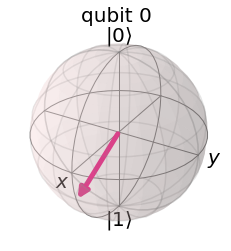

In [27]:
ket_phi = np.sqrt(0.3) * ket0 + np.sqrt(0.7) * ket1

state_phi = qi.Statevector(ket_phi)

# Plotatem do estado na Esfera de Bloch
plot_bloch_multivector(state_phi)

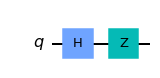

In [29]:
# Criação de um Circuito Quântico

qc =QuantumCircuit(1)

qc.h(0) # aplicação da porta Hadamard
qc.z(0) # aplicação da porta Z
qc.draw('mpl') # desenha o circuito

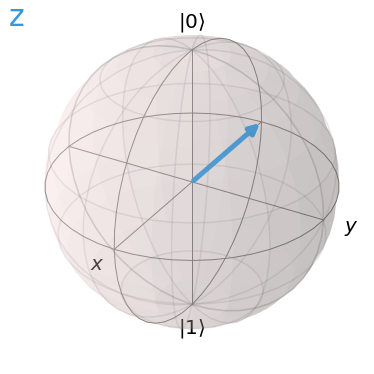

In [32]:
# Vizualizar as alterações feitas no estado pelo circuito
visualize_transition(qc)